<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Import-Packages" data-toc-modified-id="Import-Packages-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Import Packages</a></span></li><li><span><a href="#Read-in-Data" data-toc-modified-id="Read-in-Data-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Read in Data</a></span></li><li><span><a href="#EDA" data-toc-modified-id="EDA-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>EDA</a></span><ul class="toc-item"><li><span><a href="#Types-of-Crimes" data-toc-modified-id="Types-of-Crimes-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Types of Crimes</a></span><ul class="toc-item"><li><span><a href="#Theft-Sub-categories" data-toc-modified-id="Theft-Sub-categories-3.1.1"><span class="toc-item-num">3.1.1&nbsp;&nbsp;</span>Theft Sub-categories</a></span></li><li><span><a href="#Battery-sub-categories" data-toc-modified-id="Battery-sub-categories-3.1.2"><span class="toc-item-num">3.1.2&nbsp;&nbsp;</span>Battery sub-categories</a></span></li></ul></li><li><span><a href="#Maps" data-toc-modified-id="Maps-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Maps</a></span><ul class="toc-item"><li><span><a href="#Convert-Shape-file-to-GeoJSON" data-toc-modified-id="Convert-Shape-file-to-GeoJSON-3.2.1"><span class="toc-item-num">3.2.1&nbsp;&nbsp;</span>Convert Shape file to GeoJSON</a></span></li><li><span><a href="#Preprocessing" data-toc-modified-id="Preprocessing-3.2.2"><span class="toc-item-num">3.2.2&nbsp;&nbsp;</span>Preprocessing</a></span></li><li><span><a href="#Plotting" data-toc-modified-id="Plotting-3.2.3"><span class="toc-item-num">3.2.3&nbsp;&nbsp;</span>Plotting</a></span></li><li><span><a href="#Homicide-Choropleth-Map" data-toc-modified-id="Homicide-Choropleth-Map-3.2.4"><span class="toc-item-num">3.2.4&nbsp;&nbsp;</span>Homicide Choropleth Map</a></span></li></ul></li></ul></li></ul></div>

# Exploratory Data Analysis

## Import Packages

In [1]:
import numpy as np
import pandas as pd

import plotly.offline as pyoff
import plotly.graph_objects as go
import plotly.express as px

import matplotlib.pyplot as plt

import geopandas as gpd

import json
import os

pd.set_option('display.max_columns', 500)
pyoff.init_notebook_mode()

## Read in Data

In [2]:
chicago2018 = pd.read_csv('./Chicago/chicago_crimes_2018.csv',
                          index_col=0,
                          parse_dates=[2, 18])
# The Beat needs to be 0 padded if it's
# 3 digits long. Pandas automatically converted
# it to an integer....
chicago2018['Beat'] = chicago2018['Beat'].astype(str).str.zfill(4)
# Ward is a float for some reason...
# chicago2018.Ward = chicago2018.Ward.astype(int)
# chicago2018['Community Area'] = chicago2018['Community Area'].astype(int)
# To make it easier, just drop ALL NAs.
chicago2018.dropna(inplace=True)
chicago2018.head()

,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
ID,,,,,,,,,,,,,,,,,,,,,
11559376,JC108076,2018-12-22 13:00:00,036XX S RHODES AVE,1150,DECEPTIVE PRACTICE,CREDIT CARD FRAUD,RESIDENCE,False,False,0212,2,4.0,35.0,11,1180179.0,1881033.0,2018,2019-02-05 16:09:13,41.828823,-87.614435,"(41.828822656, -87.614435488)"
11552940,JC100516,2018-12-31 10:00:00,023XX N HARDING AVE,1750,OFFENSE INVOLVING CHILDREN,CHILD ABUSE,RESIDENCE,True,True,2525,25,35.0,22.0,20,1149662.0,1915232.0,2018,2019-02-05 16:09:13,41.923315,-87.725513,"(41.923314779, -87.725512504)"
11552493,JB574199,2018-12-31 18:20:00,100XX W OHARE ST,1150,DECEPTIVE PRACTICE,CREDIT CARD FRAUD,AIRPORT BUILDING NON-TERMINAL - NON-SECURE AREA,True,False,1651,16,41.0,76.0,11,1100658.0,1934241.0,2018,2019-02-05 16:09:13,41.976290,-87.905227,"(41.976290414, -87.905227221)"
11550790,JB572163,2018-12-30 01:10:00,004XX E 87TH ST,0326,ROBBERY,AGGRAVATED VEHICULAR HIJACKING,STREET,False,False,0632,6,9.0,44.0,03,1180281.0,1847388.0,2018,2019-02-05 16:09:13,41.736495,-87.615092,"(41.736495198, -87.615092361)"
11548345,JB569350,2018-07-19 09:00:00,045XX S DAMEN AVE,0890,THEFT,FROM BUILDING,DEPARTMENT STORE,True,False,0924,9,12.0,61.0,06,1163666.0,1874299.0,2018,2019-02-05 16:09:13,41.810707,-87.675210,"(41.81070701, -87.675209784)"


In [3]:
chicago2018.shape

(262995, 21)

So it looks like we got almost 263 thousand cases for the 2018 year.

In [4]:
chicago2018.sort_values(by='Date').tail()

,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
ID,,,,,,,,,,,,,,,,,,,,,
11552715,JC100026,2018-12-31 23:49:00,054XX W GLADYS AVE,041A,BATTERY,AGGRAVATED: HANDGUN,STREET,False,False,1522,15,29.0,25.0,04B,1140262.0,1897810.0,2018,2019-01-10 15:16:50,41.875684,-87.760479,"(41.87568438, -87.760479356)"
11552731,JC100031,2018-12-31 23:55:00,078XX S SANGAMON ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,False,False,0621,6,17.0,71.0,08B,1171332.0,1852934.0,2018,2019-01-10 15:16:50,41.751914,-87.647717,"(41.75191443, -87.647716532)"
11552724,JC100006,2018-12-31 23:56:00,018XX S ALLPORT ST,0440,BATTERY,AGG: HANDS/FIST/FEET NO/MINOR INJURY,OTHER,True,False,1233,12,25.0,31.0,08B,1168327.0,1891230.0,2018,2019-01-10 15:16:50,41.857068,-87.657625,"(41.857068095, -87.657625201)"
11552699,JC100043,2018-12-31 23:57:00,084XX S SANGAMON ST,1310,CRIMINAL DAMAGE,TO PROPERTY,APARTMENT,False,False,0613,6,21.0,71.0,14,1171454.0,1848783.0,2018,2019-01-10 15:16:50,41.740521,-87.647391,"(41.740520866, -87.647390719)"
11556487,JC104662,2018-12-31 23:59:00,112XX S SACRAMENTO AVE,1320,CRIMINAL DAMAGE,TO VEHICLE,STREET,False,False,2211,22,19.0,74.0,14,1158309.0,1829936.0,2018,2019-01-10 15:16:50,41.689079,-87.696064,"(41.689078832, -87.696064026)"


## EDA
We can see what are all the types of crimes are available for the 2018 year. We'll first visualize the common `Primary Type`s that are available.

### Types of Crimes

In [3]:
# Calculate counts 
unique, counts = np.unique(chicago2018['Primary Type'], return_counts=True)
# Sort them by increasing values...
unique = unique[np.argsort(counts)][::-1]
counts = np.sort(counts)[::-1]
data = [
    go.Bar(x=unique, y=counts)
]
layout = go.Layout(
    title='Frequency of Crimes for 2018',
    xaxis=dict(
        title='Crime',
        tickangle=45,
        tickfont=dict(
            size=9
        )
    ),
    yaxis=dict(
        title='Count'
    ),
    hovermode='x'
)
fig = go.Figure(data=data, layout=layout)
fig.show()

From the graph, we can see that the most common crimes are theft, battery, criminal damage, and assault. Let's see if we can delve a bit deeper into these categories with sub categories...

#### Theft Sub-categories

In [4]:
# Grab counts of thefts....
theftUnique, theftCounts = np.unique(
    chicago2018.loc[chicago2018['Primary Type'] == 'THEFT', 'Description'],
    return_counts=True
)
data = [
    go.Bar(x=theftUnique, y=theftCounts)
]
fig = go.Figure(data=data)
fig.show()

From here, we can see 4 major sub-categories for theft: \\$500 and under, from building, over \\$500, and retail theft.

#### Battery sub-categories
Same thing will be done for battery...

In [ ]:
# 

### Maps
We can also plot this data on chlorpleth maps, given the shapefiles we have. To break it down into districts, the data has the "Beat" ID of each district. According to the city of Chicago, each beat has a dedicated police car. About 3 to 5 beats make up a district.

Currently, Plotly's choropleth only supports countries and states as built-in boundaries. However, if we give it a GeoJSON file with the boundaries, then we easily adapt it. We currently have shapefiles of the beats, so we convert to the appropriate format.

#### Convert Shape file to GeoJSON

In [5]:
geodf = gpd.read_file('./Chicago/Boundaries - Police Beats (current)/'
                      'geo_export_fb1cc8b1-500e-49cd-a492-47f82d2121a5.shp')
# Create a GeoJSON file
geodf.to_file('./Chicago/Boundaries - Police Beats (current)/beats_geojson.json',
             driver='GeoJSON')

with open('./Chicago/Boundaries - Police Beats (current)/beats_geojson.json', 'r') as geofile:
    jFile = json.load(geofile)

jFile['features'][0]['properties']['beat_num']

'1713'

In [6]:
geodf['coords'] = geodf['geometry'].apply(lambda x: x.representative_point().coords[:])
geodf['coords'] = [coords[0] for coords in geodf['coords']]

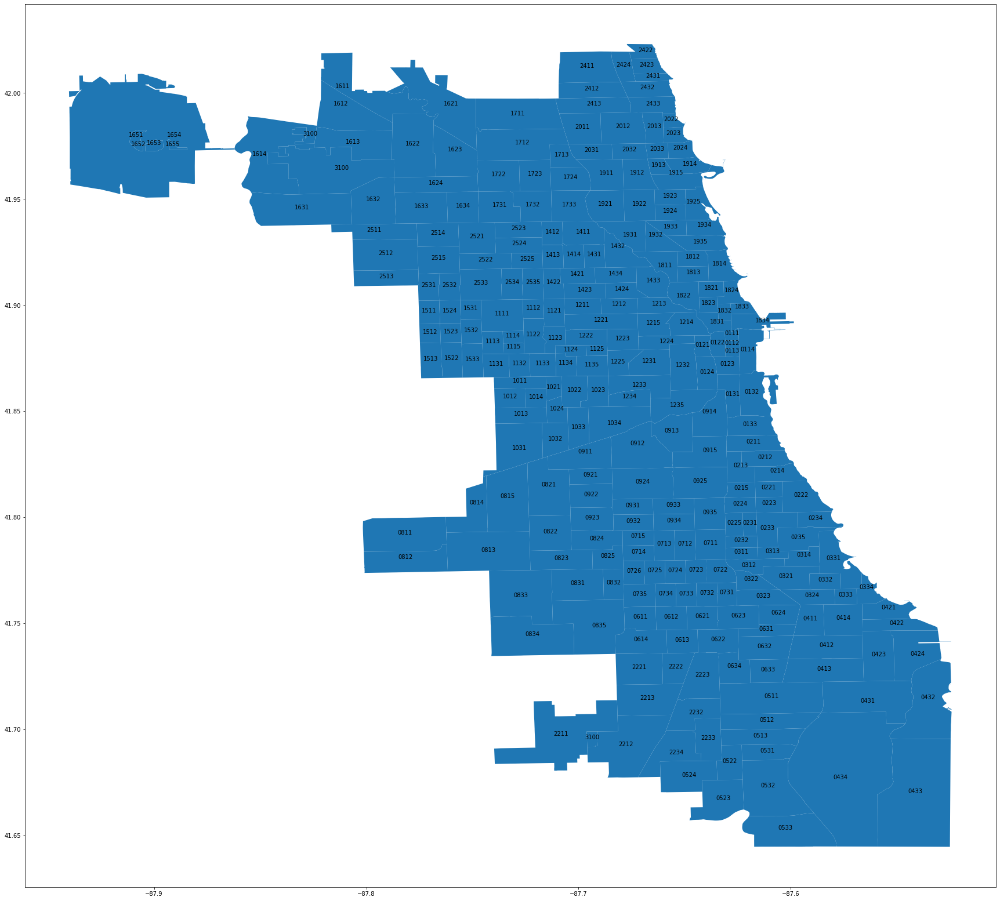

In [32]:
import matplotlib.pyplot as plt


ax = geodf.plot(figsize=(30,30))
for idx, row in geodf.iterrows():
    ax.annotate(s=row['beat_num'], xy=row['coords'], horizontalalignment='center')
plt.savefig('./figure.png')

In [ ]:
geodf.po

c:\users\mughi\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:8: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



<Figure size 1000x1000 with 0 Axes>

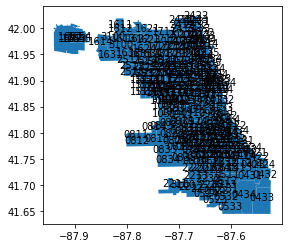

In [23]:
fig = plt.figure(figsize=(10,10), dpi=100)
def getaxessubplot():
    ax = geodf.plot()
    for idx, row in geodf.iterrows():
        ax.annotate(s=row['beat_num'], xy=row['coords'], horizontalalignment='center')
    return ax
fig.axes.append(getaxessubplot())
fig.show()

In [9]:
geodf

,beat,beat_num,district,sector,geometry,coords
0,1,1713,17,1,"POLYGON ((-87.70473 41.97577, -87.70472 41.975...","(-87.70797437850396, 41.97019918558988)"
1,0,3100,31,0,"POLYGON ((-87.83365 41.97535, -87.83366 41.974...","(-87.81173003395726, 41.96380326605743)"
2,5,1651,16,5,"POLYGON ((-87.90684 41.97656, -87.91070 41.975...","(-87.908553164847, 41.97940447790327)"
3,1,1914,19,1,"POLYGON ((-87.64492 41.96973, -87.64431 41.969...","(-87.64753786142802, 41.965804601504416)"
4,1,1915,19,1,"POLYGON ((-87.63724 41.96599, -87.63644 41.965...","(-87.65409530051221, 41.96160034997142)"
...,...,...,...,...,...,...
272,1,0314,03,1,"POLYGON ((-87.58879 41.78612, -87.58844 41.786...","(-87.5937862628318, 41.781429249265216)"
273,2,0825,08,2,"POLYGON ((-87.67917 41.78656, -87.67912 41.784...","(-87.68623585255042, 41.78099746345528)"
274,1,0313,03,1,"POLYGON ((-87.60854 41.78583, -87.60808 41.785...","(-87.6084091824194, 41.78304539022507)"
275,2,0823,08,2,"POLYGON ((-87.69354 41.78458, -87.69354 41.784...","(-87.7081021511317, 41.779773169330184)"


Notice that `beat_num` in our GeoJSON is the same as the beat number in our original dataframe. That way, when we plot a choropleth map, we can combine the two.

#### Preprocessing
First, let's take an aggregate of the entire year. We want to produce two graphs: One where we have the number of crimes in each beat, and another where we have the number of thefts in each beat. This is pretty simple using `group_by`.

In [7]:
beatGrouped = chicago2018.groupby(by='Beat')
# Run the count. Take the Case Number...
totalCrimesPerBeat = beatGrouped.count().loc[:,'Case Number']
totalCrimesPerBeat = totalCrimesPerBeat.reset_index()

Now, `plotly.express` expects the data to be in tidy format, so we actually want the `Beat` to be a column. Right now it's an `Index`. Once we do that, we tell `plotly` to match the `Beat` column in our data with `properties.beat_num` in our GeoJSON file. Center in Chicago and we're done! The color is the amount of crimes in that beat.

One thing I noted is that we have crime data for 274 beats, but our GeoJSON has 277 beats listed.

#### Plotting

In [12]:
# Reset index and send Beat to a column...
# totalCrimesPerBeat = totalCrimesPerBeat.reset_index()
fig = px.choropleth_mapbox(totalCrimesPerBeat,
                          geojson=jFile,
                          locations='Beat',
                          featureidkey='properties.beat_num',
                          center={'lat': 41.8781, 'lon': -87.6298},
                          mapbox_style='carto-positron',
                          zoom=9,
                          color='Case Number',
                          color_continuous_scale=px.colors.sequential.Inferno,
                          title='Total Crimes per Beat in 2018')
fig.update_layout(margin={'r': 0, 't': 0, 'l': 0, 'b': 0})
fig.show()

In [23]:
fig.write_html('./BeatCrimes.html')

#### Homicide Choropleth Map

In [15]:
homicides = chicago2018.loc[chicago2018['Primary Type'] == 'HOMICIDE',:]
homicides.head()

,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
ID,,,,,,,,,,,,,,,,,,,,,
24392,JB323792,2018-06-26 17:16:00,077XX S COLES AVE,0110,HOMICIDE,FIRST DEGREE MURDER,YARD,False,False,0421,4,7.0,43.0,01A,1196807.0,1854560.0,2018,2019-02-03 15:54:34,41.755781,-87.554310,"(41.755781299, -87.554309795)"
24296,JB516097,2018-11-14 20:13:00,039XX W GLADYS AVE,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,True,False,1132,11,28.0,26.0,01A,1150179.0,1898065.0,2018,2019-02-03 15:54:34,41.876197,-87.724061,"(41.876196728, -87.724060818)"
24237,JB478579,2018-10-17 02:40:00,081XX S EBERHART AVE,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,True,False,0631,6,6.0,44.0,01A,1180990.0,1851137.0,2018,2019-02-01 16:12:04,41.746767,-87.612380,"(41.746766617, -87.612379773)"
11196916,JB106192,2018-01-06 04:10:00,021XX W ADDISON ST,0142,HOMICIDE,RECKLESS HOMICIDE,STREET,True,False,1921,19,47.0,5.0,01B,1161515.0,1923886.0,2018,2019-01-30 16:14:07,41.946823,-87.681719,"(41.946823083, -87.681718565)"
24380,HZ106402,2018-08-30 07:33:00,005XX S KOSTNER AVE,0110,HOMICIDE,FIRST DEGREE MURDER,PARKING LOT,False,False,1131,11,28.0,26.0,01A,1147140.0,1897299.0,2018,2019-01-18 09:37:14,41.874153,-87.735239,"(41.874153389, -87.735238688)"


In [16]:
homicidesGrouped = homicides.groupby(by='Beat')
# Run the count. Take the Case Number...
totalHomicidesPerBeat = homicidesGrouped.count().loc[:,'Case Number']
totalHomicidesPerBeat = totalHomicidesPerBeat.reset_index()
totalHomicidesPerBeat.head()

,Beat,Case Number
0,0121,1
1,0122,1
2,0123,3
3,0133,4
4,0211,2


In [17]:
# Reset index and send Beat to a column...
# totalCrimesPerBeat = totalCrimesPerBeat.reset_index()
fig = px.choropleth_mapbox(totalHomicidesPerBeat,
                          geojson=jFile,
                          locations='Beat',
                          featureidkey='properties.beat_num',
                          center={'lat': 41.8781, 'lon': -87.6298},
                          mapbox_style='carto-positron',
                          zoom=9.5,
                          color='Case Number',
                          color_continuous_scale=px.colors.sequential.Inferno)
fig.update_layout(margin={'r': 0, 't': 0, 'l': 0, 'b': 0})
fig.show()